# Topic Clustering
Author: Andrew Auyeung

In [99]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

In [100]:
from itertools import cycle


def plot_PCA_2D(data, target, target_names=None, **kwargs):
    """
    Plots the explained variance of two principal components of a multidimensional dataset. 

    data: PCA features to plot
    target: labels for targets
    target_names: Names to assign the clusters of colors
    """
    if target_names==None:
        target_names = [f'Topic {str(i)}' for i in range(len(set(target)))]
    colors = cycle(['r','g','b','c','m','y','orange','w','aqua','yellow'])
    target_ids = range(len(target_names))
    plt.figure(figsize=(10,10))
    for i, c, label in zip(target_ids, colors, target_names):
        plt.scatter(data[target == i, 0], data[target == i, 1],
                   c=c, label=label, edgecolors='gray', **kwargs)
    plt.legend(bbox_to_anchor=(1,1))

In [101]:
# Read document topic matrix
doc_top_mat = pd.read_csv('../src/TDS_document_topic_matrix.csv', sep='\t', index_col=0)

In [102]:
doc_top_mat.head()

,article_id,date,text,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,...,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19
0,3406,2018-03-24,there is a theorem telling u there is no singl...,0.000,0.0,0.000,0.0,0.162,0.000,0.0,...,0.000,0.000,0.191,0.000,0.629,0.0,0.0,0.000,0.0,0.017
1,5405,2019-07-02,this article is a case for keeping retaining a...,0.099,0.0,0.017,0.0,0.000,0.000,0.0,...,0.000,0.000,0.852,0.015,0.000,0.0,0.0,0.016,0.0,0.000
2,5957,2019-11-26,why are competent people often so bad at teach...,0.153,0.0,0.000,0.0,0.000,0.000,0.0,...,0.000,0.045,0.802,0.000,0.000,0.0,0.0,0.000,0.0,0.000
3,6932,NaN,this article wa originally posted by derrick m...,0.000,0.0,0.000,0.0,0.256,0.016,0.0,...,0.554,0.000,0.000,0.000,0.173,0.0,0.0,0.000,0.0,0.000
4,8041,2019-07-20,in a previous article we discussed the concept...,0.000,0.0,0.000,0.0,0.000,0.000,0.0,...,0.000,0.000,0.065,0.000,0.935,0.0,0.0,0.000,0.0,0.000


In [103]:
doc_top_mat.columns

Index(['article_id', 'date', 'text', 'Topic 0', 'Topic 1', 'Topic 2',
       'Topic 3', 'Topic 4', 'Topic 5', 'Topic 6', 'Topic 7', 'Topic 8',
       'Topic 9', 'Topic 10', 'Topic 11', 'Topic 12', 'Topic 13', 'Topic 14',
       'Topic 15', 'Topic 16', 'Topic 17', 'Topic 18', 'Topic 19'],
      dtype='object')

In [104]:
# Set Train Dataset
train = doc_top_mat[['Topic 0', 'Topic 1', 'Topic 2',
       'Topic 3', 'Topic 4', 'Topic 5', 'Topic 6', 'Topic 7', 'Topic 8',
       'Topic 9', 'Topic 10', 'Topic 11', 'Topic 12', 'Topic 13', 'Topic 14',
       'Topic 15', 'Topic 16', 'Topic 17', 'Topic 18', 'Topic 19']]


## KMeans

In [10]:
inertias = []
for i in range(1, 30):
    km = KMeans(n_clusters=i, n_jobs=-1)
    km.fit(train)
    inertias.append(km.inertia_)

Text(0, 0.5, 'Inertia')

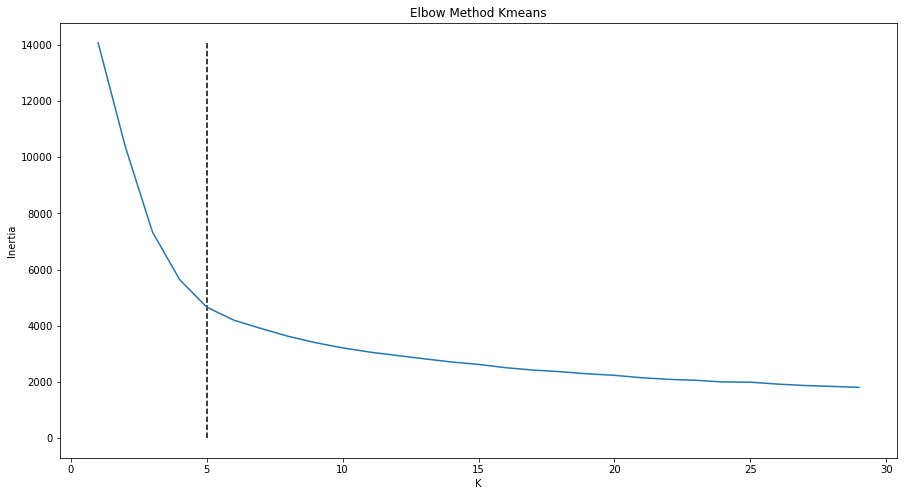

In [15]:
plt.figure(figsize=(15,8))

plt.plot(range(1,30), inertias)
plt.vlines(x=5, ymax=max(inertias), ymin=0, linestyles='--')
plt.title('Elbow Method Kmeans')
plt.xlabel('K')
plt.ylabel('Inertia')

In [16]:
km_5 = KMeans(n_clusters=5, n_jobs=-1)
clusters = km_5.fit_transform(train)

In [17]:
cluster_labels = np.argmax(clusters, axis=1)

In [18]:
clusters

array([[0.77867053, 0.54957944, 0.21507351, 0.84485275, 0.873351  ],
       [1.04794603, 0.68525723, 1.09623152, 0.11127089, 1.03951615],
       [1.01762514, 0.63343441, 1.0662835 , 0.11849678, 1.00829209],
       ...,
       [0.22097791, 0.65048552, 0.95795726, 0.99349683, 0.73038919],
       [0.9745239 , 0.60746434, 1.02644479, 0.16165914, 0.96792819],
       [0.89811215, 0.49210596, 0.68523676, 0.36270097, 0.87437913]])

In [18]:
len(cluster_labels)

35646

In [19]:
# Visualize clusters
from sklearn.decomposition import PCA
pca_features = PCA(2).fit_transform(train)

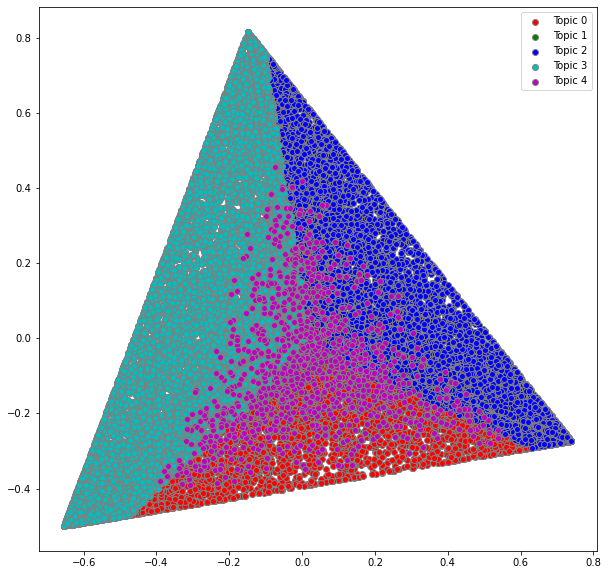

In [21]:
plot_PCA_2D(pca_features, cluster_labels, [f'Topic {str(i)}' for i in range(5)])

## Agglomerative Clustering

In [105]:
from sklearn.cluster import AgglomerativeClustering

ac = AgglomerativeClustering(n_clusters=5)


In [106]:
ac_topics = ac.fit_predict(train)

In [107]:
len(set(ac_topics))

5

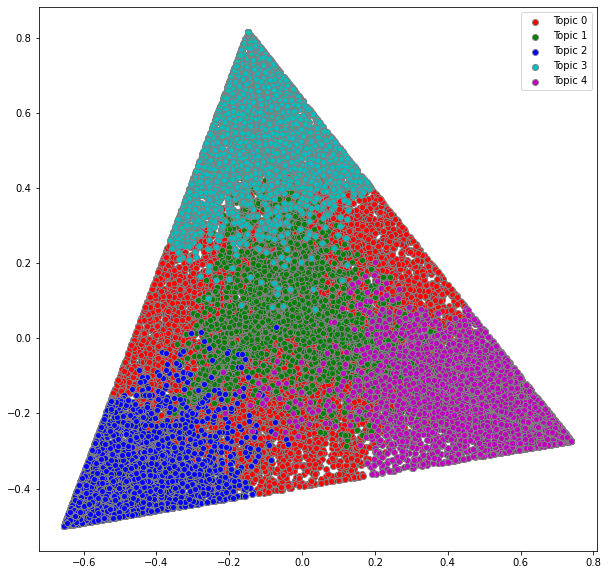

In [108]:
plot_PCA_2D(pca_features, ac_topics)

In [109]:
from sklearn.metrics import silhouette_score, silhouette_samples
import numpy as np

In [120]:
def plot_silhouette(X, clusters):
    """
    Code adapted from https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
    Re-written for plotting scores given data and cluster labels
    """

    fig = plt.figure(figsize=(15,8))
    s_score = silhouette_score(X, clusters)
    print(f'The average silhouette score is {s_score}')

    all_scores = silhouette_samples(X, clusters)
    n_clusters = set(clusters)

    y_lower = 10
    for cluster in n_clusters:
        # iterate through clusters
        # get scores from current cluster
        current_cluster_silhouette_scores = all_scores[clusters==cluster]

        current_cluster_silhouette_scores.sort()

        size_current_cluster = current_cluster_silhouette_scores.shape[0]
        # set boundaries for plotting new bars
        y_upper = y_lower + size_current_cluster 

        plt.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            current_cluster_silhouette_scores,
            )
        plt.text(-0.05, y_lower + 0.5*size_current_cluster, str(cluster))

        y_lower = y_upper + 10
    



The average silhouette score is 0.30540088852611735


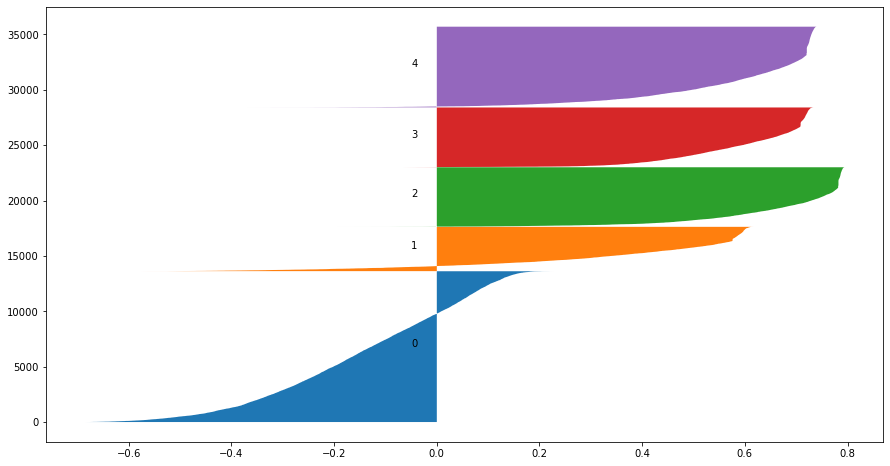

In [111]:
plot_silhouette(train, ac_topics)

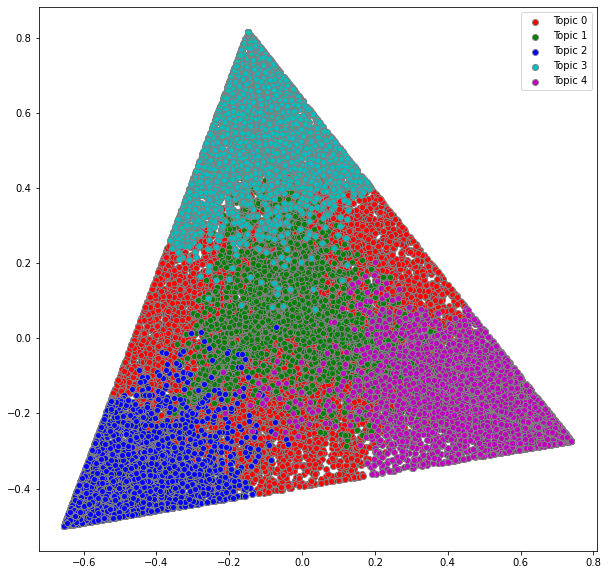

In [112]:
plot_PCA_2D(pca_features, ac_topics)

### Results: 
5 agglomerative clusters show good silhouette scores for 4/5 groups.  Try larger groups? 

In [116]:
# Try Agglomerative Clustering with 4 Clusters
ac_6 = AgglomerativeClustering(n_clusters=6)
ac_6_topics = ac_6.fit_predict(train)

The average silhouette score is 0.3211930271035341


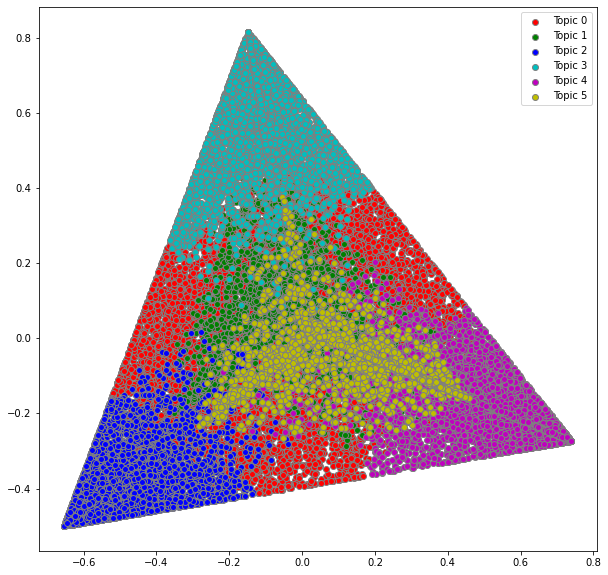

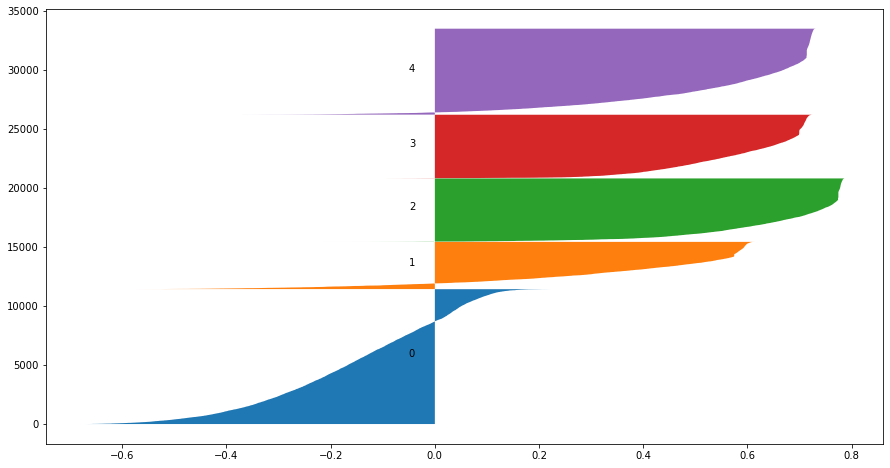

In [117]:
plot_PCA_2D(pca_features, ac_6_topics)
plot_silhouette(train, ac_6_topics)